In [1]:
%%capture
#%conda install -c plotly plotly=5.9.0
#%conda install pip
#%conda install twisted

%pip install plotly==5.9.0
%pip install twisted
%pip install pandas
%pip install ta    
%pip install scikit-learn
%pip install tensorflow
%pip install keras
%pip install matplotlib
%pip install scikeras
%pip install keras-tuner
%pip install plotly
%pip install nbformat
%pip install lightgbm
%pip install seaborn
    
#%pip install huobi-sdk==2.3.3

import pandas as pd
import numpy as np    
pd.set_option('display.max_columns', None)
pd.set_option('display.expand_frame_repr', False)
pd.set_option('max_colwidth', None)

import os
# Downloading latest pytrade2 data
#os.system("cd ./../deploy/yandex_cloud; ./download_data.sh")
data_dir=f"../data/dev/common"
#print(f"Download completed. Local data dir: {data_dir}")

In [2]:
symbol="BTC-USDT"

is_keras=True
is_lgb=True
is_prev_candles_features=False
history_days=100
#test_size=2/history_days # 2 days
test_size = 0.1
features_periods = ['5min', '10min', '15min', '30min', '1h']
if is_prev_candles_features:
    candles_features_cnts={'5min':5, '15min':5} 
predict_window = '5min'

# 0.01*0.012*2 - open+close comission 0.012%
# Comission is 4.8 for 40K price, ~10 for one open+close trade
comission_pct=0.012

comission=0.01*comission_pct*2 # doubled because open and close trade

open_ratio = 2
min_profit_ratio = (comission) * 5
max_loss_ratio = (comission) * 10

print(f'test size = {test_size}')

test size = 0.1


## Read candles history

In [3]:
from pathlib import Path

def read_candles(days = 1, period = '1min'):
    """ Read last days' 1 min candles from file system """

    candles_dir = Path(data_dir, 'candles')
    files = sorted([f for f in os.listdir(candles_dir) if f.endswith(f"candles_{period}.csv")])
    # Read last days' files to one dataframe
    df = pd.concat([pd.read_csv(Path(candles_dir, fname), parse_dates=['open_time', 'close_time']) for fname in files[-days:]])
    df = df.set_index('close_time', drop=False)
    #del(df['close_time.1']) # temp fix
    # Resample because row data contains multiple candles inside a period
    print(f'Read {len(df)} candles from {df.index.min()} to {df.index.max()}')
    return df.resample('1min').agg('last')

candles = read_candles(days=history_days)
candles.tail()

Read 144000 candles from 2023-10-25 00:01:00 to 2024-02-02 00:00:00


,close_time,open_time,ticker,interval,open,high,low,close,vol
close_time,,,,,,,,,
2024-02-01 23:56:00,2024-02-01 23:56:00,2024-02-01 23:55:00,BTC-USDT,1min,43081.4,43085.7,43081.3,43081.3,2704
2024-02-01 23:57:00,2024-02-01 23:57:00,2024-02-01 23:56:00,BTC-USDT,1min,43077.8,43082.6,43077.8,43082.6,74
2024-02-01 23:58:00,2024-02-01 23:58:00,2024-02-01 23:57:00,BTC-USDT,1min,43082.7,43091.1,43082.7,43091.1,402
2024-02-01 23:59:00,2024-02-01 23:59:00,2024-02-01 23:58:00,BTC-USDT,1min,43091.1,43091.1,43091.1,43091.1,312
2024-02-02 00:00:00,2024-02-02 00:00:00,2024-02-01 23:59:00,BTC-USDT,1min,43094.7,43106.5,43094.7,43102.4,4038


## Calculate targets

In [4]:
import matplotlib.pyplot as plt

def plot_value_counts(ax, df, col, grouped, name):
    signals = df[col]
    #vc = signals[signals.diff() != 0].value_counts()
    vc = df[col].value_counts() if not grouped else signals[(signals.diff() != 0) & (signals != 0)].value_counts()
    label_map={0:'oom', 1:'buy', -1: 'sell'}
    color_map={'oom':'C0', 'buy': 'C1', 'sell': 'C2'}
    labels = [ label_map[signal] for signal in vc.index.tolist()]
    colors = [color_map[key] for key in labels]
    ax.pie(vc, labels = labels,  autopct= lambda x: '{:.0f}'.format(x*vc.sum()/100), colors = colors)
    tag = 'groups' if grouped else ''
    ax.set_title(f"{name} {col} {tag}")
    
def plot_signal_counts(df, name = ''):
    fig, (ax1, ax2) = plt.subplots(1, 2) 
    plot_value_counts(ax1, df, 'signal', grouped = False, name=name)
    plot_value_counts(ax2, df, 'signal', grouped = True, name=name)
    fig.suptitle(f'{name} signal counts from {df.index.min()} to {df.index.max()}')
    plt.show()

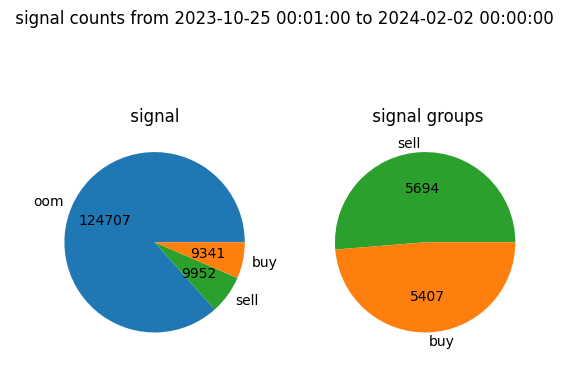

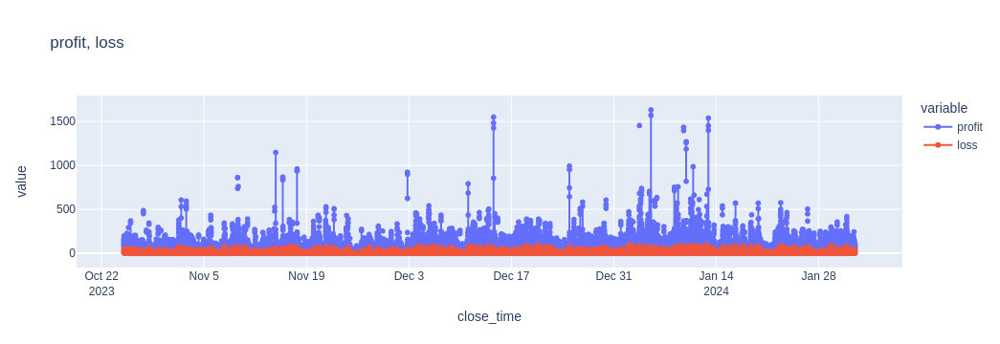

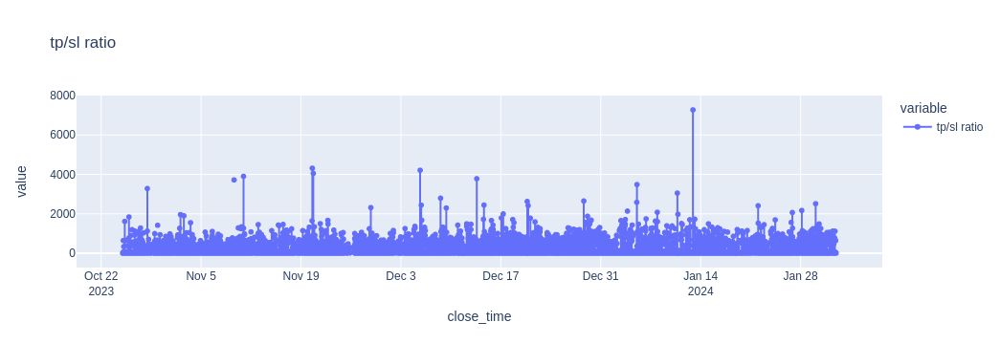

In [5]:

def calc_fut_lohi(candles, predict_window=predict_window):
    fut_lohi = pd.DataFrame(index=candles.index)
    fut_lohi[['fut_low', 'fut_high']] = (candles[['low', 'high']][::-1]
                                     .rolling(predict_window).agg({ 'low' : 'min', 'high' : 'max'})
                                     [::-1])
    # Drop last data with unfinished prediction windows
    fut_lohi = fut_lohi.iloc[fut_lohi.index <= max(fut_lohi.index)-pd.Timedelta(predict_window)]    
    return fut_lohi
    
def calc_signal(candles, fut_lohi, open_ratio=open_ratio, min_profit_ratio=min_profit_ratio, max_loss_ratio=max_loss_ratio, comission_pct=comission_pct):
    """ Signal -1,0,1 plus extended debugging info """
    #next_candles = candles[['open', 'high', 'low', 'close', 'vol']].shift(1)

    # next_candles = pd.DataFrame(index=candles.index)
    # next_candles[['high', 'low']] = (candles[['high', 'low']][::-1]
    #                                  .rolling(predict_window).agg({'high' : 'max', 'low' : 'min'})
    #                                  [::-1])

    # BTC-USDT 40 000 * 1% = 400
    # BTC-USDT 40 000 * 0.012% = 40 * 0.012 = 4,8
    #comission = comission_pct*0.01 
    comiss_abs = candles['close'] * comission_pct*0.01*2
    # Ratio to open: generate signal if profit/loss > open ratio
    #open_ratio = 1
    min_profit = candles['close']* min(comission_pct*0.01*2, min_profit_ratio)
    max_loss = candles['close']*max_loss_ratio
    
    signal = pd.DataFrame(index=candles.index)

    # todo: calc signal here
    # Profit / loss > open ratio considering comission and minimal profit
    profit_sell = (candles['low'] - fut_lohi['fut_low']) - comiss_abs
    loss_sell = (fut_lohi['fut_high'] - candles['low']) + comiss_abs
    signal_sell = (profit_sell > 0) & ((profit_sell / loss_sell) > open_ratio) & (profit_sell > min_profit) & (loss_sell < max_loss)

    
    # Profit / loss > open ratio considering comission and minimal profit
    profit_buy = (fut_lohi['fut_high'] - candles['high']) - comiss_abs
    loss_buy =  (candles['high'] - fut_lohi['fut_low']) + comiss_abs
    signal_buy = (profit_buy > 0) & ((profit_buy / loss_buy) > open_ratio)& (profit_buy > min_profit) & (loss_buy < max_loss)


    # Signal
    signal['signal'] = 0  # Default to 0
    signal.loc[signal_buy & ~signal_sell, 'signal'] = 1  # Set to 1 where 'buy' is True and 'sell' is False
    signal.loc[~signal_buy & signal_sell, 'signal'] = -1  # Set to -1 where 'sell' is True and 'buy' is False

    df = signal
    # Future profit and loss
    df.loc[signal['signal']==1, 'tp'] = fut_lohi['fut_high']
    df.loc[signal['signal']==1, 'sl'] = fut_lohi['fut_low']
    df.loc[signal['signal']==-1, 'tp'] = fut_lohi['fut_low']
    df.loc[signal['signal']==-1, 'sl'] = fut_lohi['fut_high']

    return df

def plot_sl_tp(candles, signal):
    # Line plot, profit/loss
    import plotly.express as px
    import warnings
    # Supress pandas+plotly warning
    warnings.simplefilter(action='ignore', category=FutureWarning)
    #px.line(signal, title='profit/loss').update_traces(mode='lines+markers').show()

    sltp = signal.copy()
    sltp['profit'] = (signal['tp'] - candles['close']).abs()
    sltp['loss'] = (signal['sl'] - candles['close']).abs()
    sltp['tp/sl ratio'] = sltp['profit']/sltp['loss']
    px.line(sltp[['profit','loss']], title='profit, loss').update_traces(mode='lines+markers').show()
    px.line(sltp['tp/sl ratio'], title='tp/sl ratio').update_traces(mode='lines+markers').show()
    
    #px.line(profits/losses, title='profit/loss ratio').update_traces(mode='lines+markers').show()
    
    pd.concat([candles, fut_lohi], axis=1).head()

candles.head()
fut_lohi = calc_fut_lohi(candles, predict_window)
signal = (calc_signal(candles, 
                      fut_lohi = fut_lohi, 
                      open_ratio = open_ratio, 
                      # 0.01*0.012*2 - open+close comission 0.012%
                      # Comission is 4.8 for 40K price, ~10 for one open+close trade
                      min_profit_ratio = min_profit_ratio,
                      max_loss_ratio = max_loss_ratio)
         )



# Pie plot, signals
plot_signal_counts(signal)
plot_sl_tp(candles, signal)


## Feature engineering


### Calculate indicators

In [6]:
from ta import trend, momentum, volume, others, volatility


def time_parts_of(candles: pd.DataFrame):
    # dt = df.index.to_frame()["close_time"].dt
    df = pd.DataFrame(index=candles.index)
    dt = df.index.astype('datetime64[ns]')
    df["time_hour"] = dt.hour
    df["time_minute"] = dt.minute
    return df

def ichimoku_of(candles: pd.DataFrame, period: str=''):
    df = pd.DataFrame()
    ichimoku = trend.IchimokuIndicator(candles['high'], candles['low'])
    df[f'ichimoku_base_line_{period}'] = ichimoku.ichimoku_base_line()
    df[f'ichimoku_conversion_line_{period}'] = ichimoku.ichimoku_conversion_line()
    df[f'ichimoku_a_{period}'] = ichimoku.ichimoku_a()
    df[f'ichimoku_b_{period}'] = ichimoku.ichimoku_b()    
    return df


    return features.dropna()    

def indicators_of(candles, period):
    resampled = candles.resample(period).agg({'high':max, 'low':min, 'open': 'first', 'close': 'last', 'vol': sum})
    df = ichimoku_of(resampled, period)
    df[f'cci_{period}'] = trend.cci(resampled['high'], resampled['low'], resampled['close'])
    df[f'adx_{period}'] = trend.adx(resampled['high'], resampled['low'], resampled['close'])
    df[f'rsi_{period}'] = momentum.rsi(resampled['close'])
    df[f'stoch_{period}'] = momentum.stoch(resampled['high'], resampled['low'], resampled['close'])
    df[f'macd_{period}'] = trend.macd(resampled['close'])
    #df = features.dropna()
    return df

# Create time features and indicators
indi_features = time_parts_of(candles)
#indi_features = pd.concat([indi_features] + [indicators_of(candles,period) for period in ['1min', '5min', '15min', '30min', '60min']], axis=1).ffill()
indi_features = pd.concat([indi_features] + [indicators_of(candles,period) for period in features_periods], axis=1).ffill()
indi_features.tail()
features = indi_features

### Previous candles features

In [7]:
from typing import Dict    
from functools import reduce

def prev_candles_of(candles: pd.DataFrame, period: str, window_size: int):
    candles = candles.resample(period, label='right').agg({'close_time':'last', 'open': 'first', 'high':'max', 'low':'min', 'close':'last', 'vol':'sum'})
    df = candles[["open", "high", "low", "close", "vol"]]
    cols = ["open", "high", "low", "close", "vol"]
    features = candles[cols].copy()
    # Add previous window candles to columns
    concat_features = []
    for i in range(0, window_size+1):
        prefix = f"{period}_-{i}"
        prev_features = features[cols].shift(i).add_prefix(prefix)
        concat_features.append(prev_features)
    features = pd.concat(concat_features, axis=1).sort_index()
    return features

def candles_features_of(candles: pd.DataFrame, candles_counts: Dict[str, int])->pd.DataFrame:
    prev_candles_lst = [prev_candles_of(candles, period, cnt) for period, cnt in candles_counts.items()]
    # return reduce(lambda c1,c2: c1.merge(c2, left_index=True, right_index=True), prev_candles).ffill().sort_index()
    return (pd.concat(prev_candles_lst, axis=1)
            .ffill()
            .dropna()
            .sort_index())

if is_prev_candles_features:
    prev_candles_features = candles_features_of(candles, candles_features_cnts)
    features = pd.concat([indi_features, prev_candles_features], axis=1).dropna()
    features.tail()

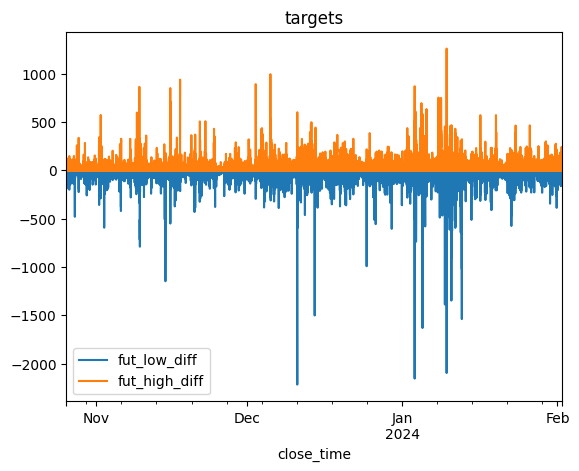

In [8]:
def prepare_xy(candles, features, targets):
    t = pd.DataFrame()
    t['fut_low_diff'] = targets['fut_low'] - candles['low']
    t['fut_high_diff'] = targets['fut_high'] - candles['high']
    t = t.dropna()
    
    f = features.copy()
    float_cols=[c for c in f.columns if not c.startswith('time') and not c.endswith('time')]
    f[float_cols]=f[float_cols].diff()
    f = f.dropna()

    ii = t.index.intersection(f.index)
    f,t = f.loc[ii,:], t.loc[ii,:]
    return f,t

x, y = prepare_xy(candles, features, fut_lohi)
y.plot(title='targets')
plt.show()

In [9]:
import plotly as py
from plotly import graph_objects as go
from plotly.subplots import make_subplots

def plot_indicators(candles, df, extra_lines:[], extra_subplots:[]):
    fig = make_subplots(rows=len(extra_subplots)+1, cols=1, 
                        shared_xaxes=True,
                        vertical_spacing=0.02,
                        subplot_titles=['candles']+extra_subplots
                       )    
    
    # Candles
    fig.add_trace(go.Candlestick(\
                        name='candles',
                        x=candles.index,\
                        open=candles['open'],\
                        high=candles['high'],\
                        low=candles['low'],\
                        close=candles['close'])
                     , row=1, col=1)

    # Other charts on candles chart
    for name in extra_lines:
        fig.add_trace(go.Scatter(name=name, x=df.index, y=df[name], mode='lines'), row=1, col=1)

    # Other subplots below candles
    for i, col in enumerate(extra_subplots):
        fig.add_trace(go.Scatter(name=col, x=df.index,y=df[col], mode='lines'), row=2+i, col=1)
    
    fig.update_layout(title=f"{candles['ticker'][0]}",
                    xaxis_rangeslider_visible=False, 
                    height=300*len(extra_subplots))
    fig.show()

suffix = f'_{min(features_periods)}'
ichimoku_cols = [f'ichimoku_base_line{suffix}', f'ichimoku_conversion_line{suffix}', f'ichimoku_a{suffix}', f'ichimoku_b{suffix}']
indicators_cols = [f'cci{suffix}', f'adx{suffix}', f'rsi{suffix}', f'stoch{suffix}']
if set(indicators_cols) in set(features.columns):
    plot_indicators(
                candles.tail(100),
                features.tail(100), 
                 extra_lines=ichimoku_cols,
                 extra_subplots=indicators_cols)


### Create features

<Axes: >

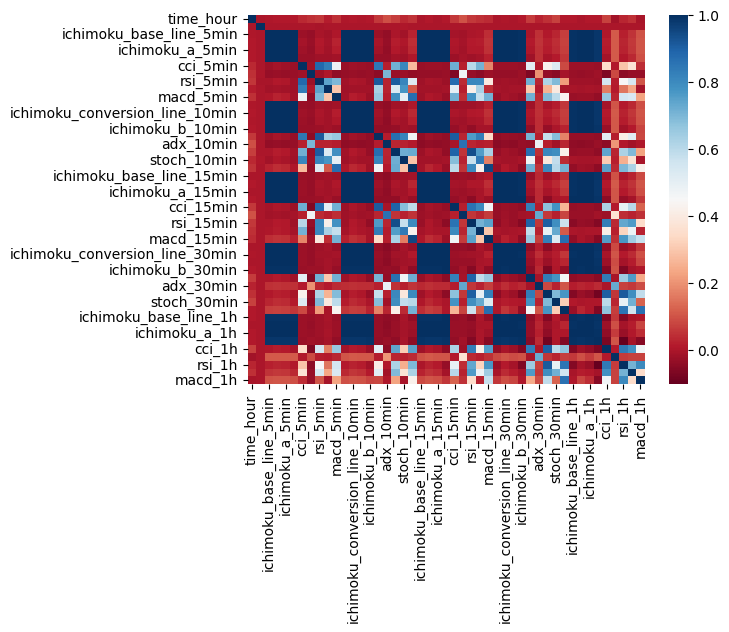

In [10]:
import seaborn as sb
corr = features.corr()
kot = corr[corr.abs()>=.5]
#corr = corr[((dfCorr >= .5) | (dfCorr <= -.5)) & (dfCorr !=1.000)]
# Plot the heatmap between features in the dataframe
sb.heatmap(corr, annot=False,
           cbar=True, cmap='RdBu', fmt='.1f')

In [11]:
import tensorflow as tf
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler, MinMaxScaler, OneHotEncoder, StandardScaler, MaxAbsScaler, PowerTransformer
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split


def create_pipe(X, y) -> (Pipeline, Pipeline):
    """ Create feature and target pipelines to use for transform and inverse transform """

    time_cols = [col for col in X.columns if col.startswith("time") or col.endswith("time")]
    float_cols = list(set(X.columns) - set(time_cols))

    # # Scale x
    # x_pipe = Pipeline(
    #     [
    #     ("xrs", ColumnTransformer([("xrs", StandardScaler(), float_cols)], remainder="passthrough")),
    #     ("mas", MaxAbsScaler()),
    #     ])

    # x_pipe.fit(X)

    # # Scale y
    # y_pipe = Pipeline(
    #     [
    #    ("xrs", StandardScaler()),
    #     ("ymms", MaxAbsScaler()),
    #     ])
    # y_pipe.fit(y)

    
    # Scale x
    x_pipe = Pipeline(
        [
        ("xscaler", ColumnTransformer([("xrs", StandardScaler(), float_cols)], remainder="passthrough")),
        ("mas", MaxAbsScaler()),
        ])
    x_pipe.fit(X)

    # Scale y
    y_pipe = Pipeline(
        [
        ("xrs", StandardScaler()),
        ("ymms", MaxAbsScaler()),
        ])
    y_pipe.fit(y)
    return x_pipe, y_pipe


x_train_df, x_test_df, y_train_df, y_test_df = train_test_split(x, y, test_size=test_size, shuffle=False)
x_pipe, y_pipe = create_pipe(x_train_df, y_train_df)
float_cols = [col for col in x_train_df.columns if not col.startswith('time')]

x_train_df[float_cols] = x_train_df[float_cols].diff()
x_train_df = x_train_df.dropna()
y_train_df = y_train_df[y_train_df.index.isin(x_train_df.index)]
x_test_df[float_cols] = x_test_df[float_cols].diff()
x_test_df = x_test_df.dropna()
y_test_df = y_test_df[y_test_df.index.isin(x_test_df.index)]

x_train = x_pipe.transform(x_train_df)
x_test = x_pipe.transform(x_test_df)
y_train = y_pipe.transform(y_train_df)
y_test = y_pipe.transform(y_test_df)

2024-02-03 00:53:30.396248: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-03 00:53:30.396280: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-03 00:53:30.397410: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-03 00:53:30.403370: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-03 00:53:31.192014: W tensorflow/comp

## Try keras model

In [12]:
models={}

Creating model([47]), input shape=(47,)
Creating model([47, 188, 16]), input shape=(47,)
Creating model([47, 47, 188, 64, 16]), input shape=(47,)
Evaluating keras [47]


2024-02-03 00:53:32.358771: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2256] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


Epoch 1/10
12825/12825 [==============================] - 13s 987us/step - loss: 7.0497e-04 - mean_squared_error: 7.0497e-04 - val_loss: 4.4913e-04 - val_mean_squared_error: 4.4913e-04
Epoch 2/10
12825/12825 [==============================] - 13s 996us/step - loss: 6.3645e-04 - mean_squared_error: 6.3645e-04 - val_loss: 4.6029e-04 - val_mean_squared_error: 4.6029e-04
Epoch 3/10
12825/12825 [==============================] - 12s 932us/step - loss: 6.2978e-04 - mean_squared_error: 6.2978e-04 - val_loss: 4.4582e-04 - val_mean_squared_error: 4.4582e-04
Epoch 4/10
12825/12825 [==============================] - 12s 959us/step - loss: 6.2973e-04 - mean_squared_error: 6.2973e-04 - val_loss: 4.4839e-04 - val_mean_squared_error: 4.4839e-04
Epoch 5/10
12825/12825 [==============================] - 12s 956us/step - loss: 6.2904e-04 - mean_squared_error: 6.2904e-04 - val_loss: 4.5806e-04 - val_mean_squared_error: 4.5806e-04
Epoch 6/10
12825/12825 [==============================] - 12s 952us/step - 

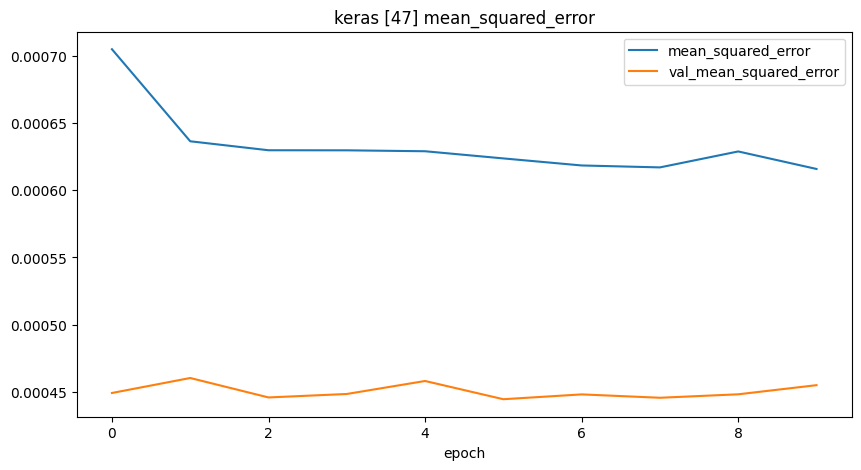

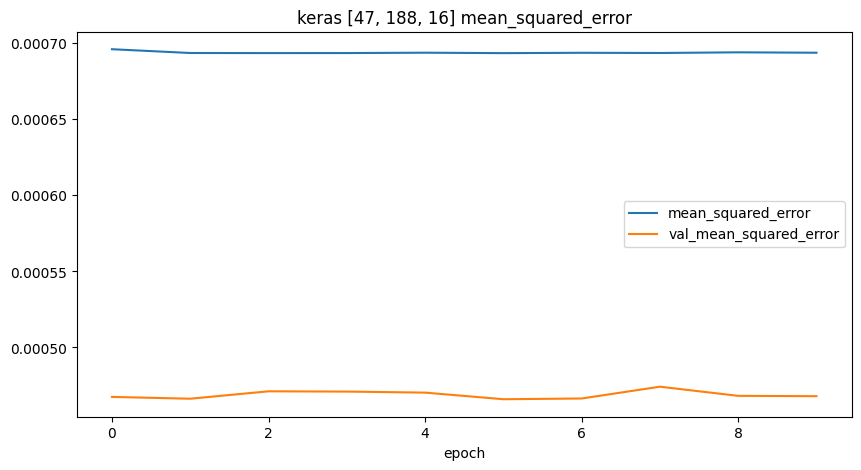

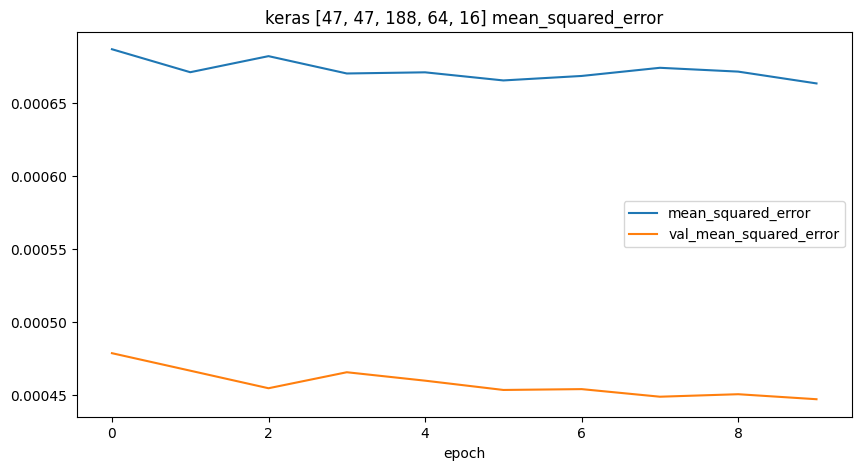

In [13]:
from keras import Sequential, Input
from keras.layers import Dense, Dropout
import plotly.express as px
import collections


plot_figsize=(10,5)

def create_models(*specs):
    models = {}
    for unit_spec in specs:
        window_size=unit_spec[0]
        models[f'keras '+str(unit_spec)] =create_model(x_train, y_train, unit_spec)
    return models

def create_model(x_train,  y_train, specs):
    """ Create model with layers given in specs """

    input_shape=(x_train.shape[1],)
    print(f"Creating model({specs}), input shape={input_shape}")

    model = Sequential()
    model.add(Input(shape=input_shape))

    # Keras layers
    for units in specs:
        model.add(Dense(units, activation='relu'))
        model.add(Dropout(0.2))

    # Output layer
    model.add(Dense(y_train.shape[1], activation='linear')) # Softmax for classification
    model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mean_squared_error'])
    #print(model.summary())
    return model

def plot_history_plotly(df, title):
    px.line(df,title=title).update_traces(mode='lines+markers').show()
    
def plot_history_plt(df, title):
        plt.plot(df)
        #Captions and show the plot
        plt.title(title)
        plt.xlabel('epoch')
        plt.legend(df.columns)
        plt.show()    

def plot_history(model_name, history, plot_func, metric=None):
    """ Plot history loss and metrics"""
    metric_names = [metric] if metric else history.history
    # Print all merrics
    for metric_name in metric_names:
        # Validation metrics names will be calculated from related train metrics
        if metric_name.startswith("val_"): continue

        # Plot metric and related test (val_..) metric
        plt.figure(figsize=plot_figsize)
        title=f"{model_name} {metric_name}"
        names=[metric_name, f"val_{metric_name}"]
        
        df=pd.DataFrame()
        for name in names:
            df[name] = history.history[name]
        plot_func(df, title)

def evaluate_keras_models(models, epochs=10):
    results={}
    for name, model in models.items():
        print('Evaluating ' + name)
        steps_per_epoch=max(1,x_train.shape[0]//epochs)+1
        history=model.fit(x_train, y_train, validation_data=(x_test, y_test), epochs=epochs, steps_per_epoch=steps_per_epoch, verbose=1)
        results[name] = history
    return results

def plot_res(results, plot_func):
    for model_name in results:
        plot_history(model_name, results[model_name], plot_func, metric='mean_squared_error')

        
# # Good: Current LSTM2: 10, 320, 0.2, 160, 0.2, 40, 0.2, 16, 0.1
if is_keras:
    input_size = x_train.shape[1]
    
    keras_models = create_models([input_size],
                                [input_size, input_size*4, 16],
                                [input_size, input_size, input_size*4, 64,16])
    models.update(keras_models)
    eval_res = evaluate_keras_models(keras_models, 10)
    
    plot_res(eval_res, plot_history_plt)

## Try lightdbm

In [14]:
import lightgbm as lgb
from sklearn.multioutput import MultiOutputRegressor
def eval_lgb_model(lgb_model, train_data, test_data):
    # Defining parameters for the LightGBM
    params = {
        'objective': 'regression',
        'metric': ['mse', 'mae', 'rmse', 'r2'],
        'verbose': -1
    }
    rounds = 100
    evals = {}
    #model.fit(x_train, y_train, callbacks=[lgb.record_evaluation(evals)])
    model.fit(train_data, test_data, callbacks=[lgb.record_evaluation(evals)])
    return model, evals

if is_lgb:
    lgb_model=lgb.LGBMRegressor()
    model = MultiOutputRegressor(lgb_model)
    #models['lgbm1'] = model
    lgb_models = {'lgb1': model}
    models.update(lgb_models)
    
    model, evals = eval_lgb_model(lgb_model, x_train, y_train)
    for metrics in evals.values():
        for metric in metrics:
            lgb.plot_metric(evals, metric)


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008813 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 11559
[LightGBM] [Info] Number of data points in the train set: 128244, number of used features: 47
[LightGBM] [Info] Start training from score -0.000000
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006481 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 11559
[LightGBM] [Info] Number of data points in the train set: 128244, number of used features: 47
[LightGBM] [Info] Start training from score -0.000000


## Calculate test profit

Calculating profit of model lgb1
Mean profit: 35.9199148302225
Mean buy: 50.06792740817355
Mean sell: 16.250726612095427
Median profit: -2.1156008954931167
Median buy: -0.26657314159092493
Median sell: -8.866472012879967


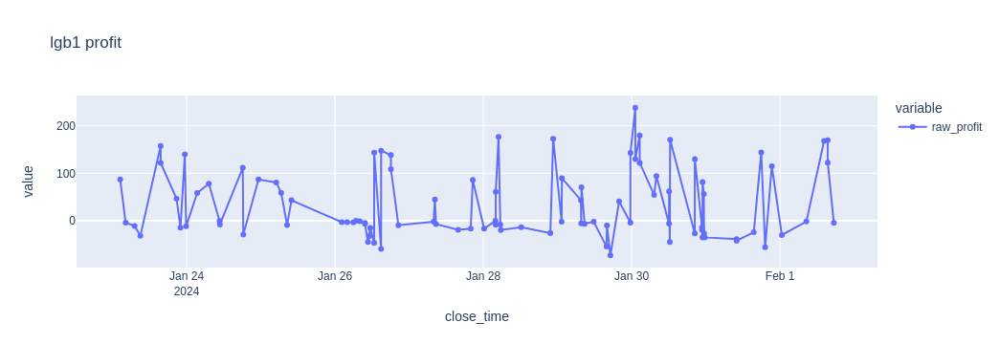

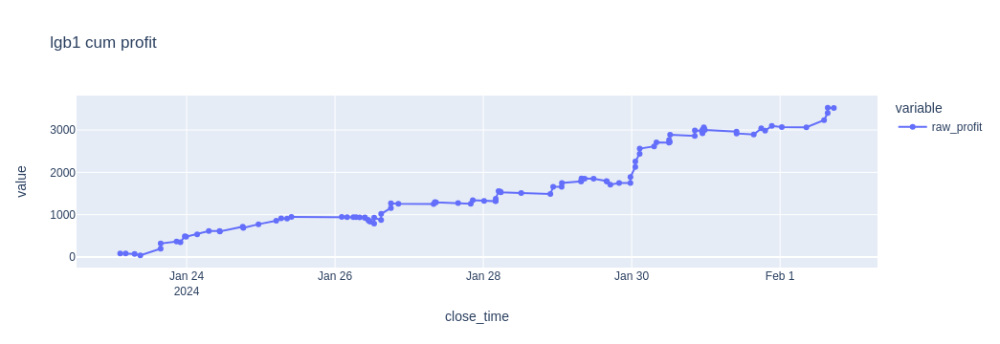

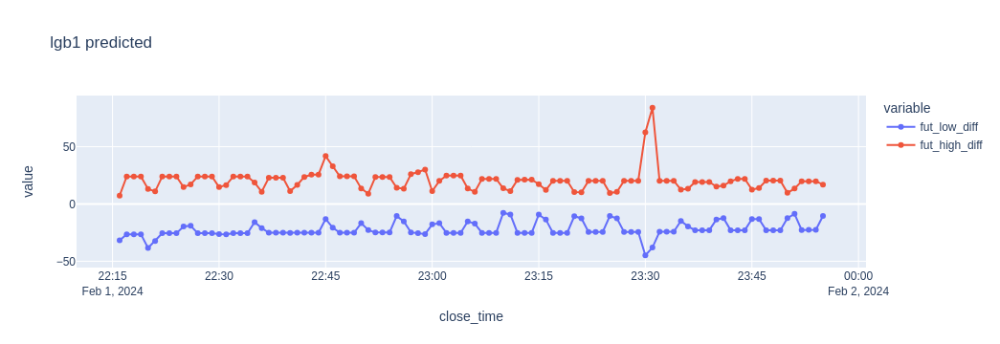

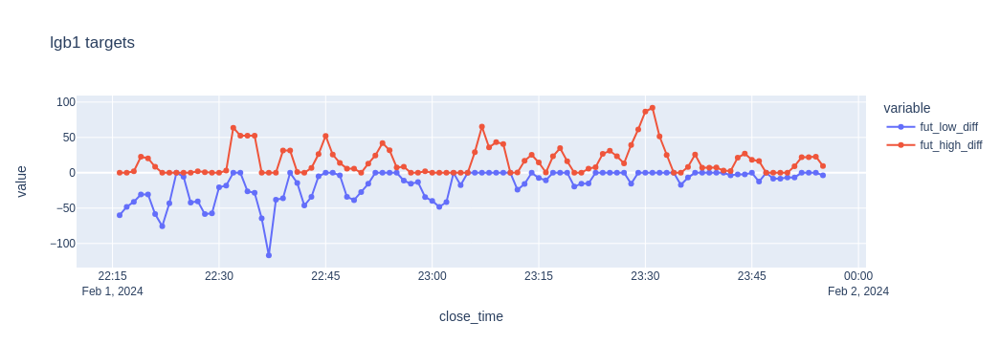

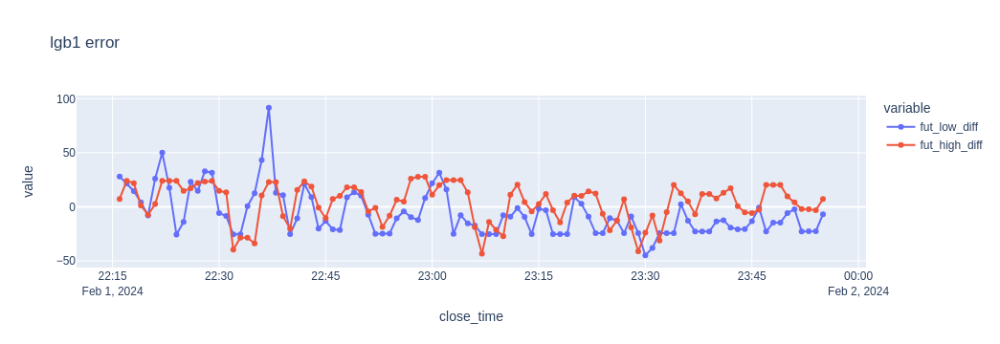

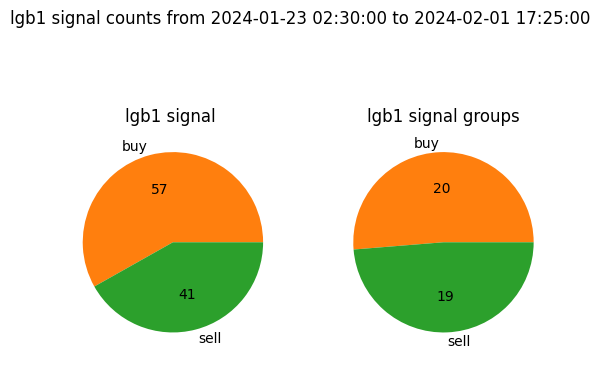

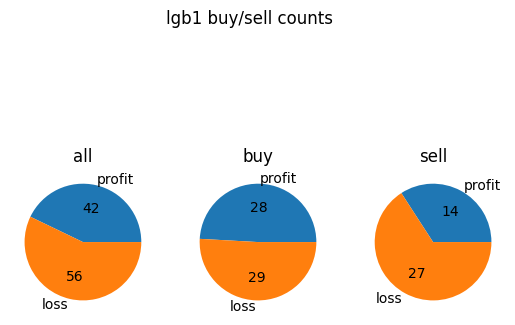

Calculating profit of model keras [47]
446/446 [==============================] - 0s 577us/step
Mean profit: 52.34101275783087
Mean buy: 121.06588567097909
Mean sell: 36.48142670095051
Median profit: 25.419120264054072
Median buy: 121.6480712890625
Median sell: -6.945943069455097


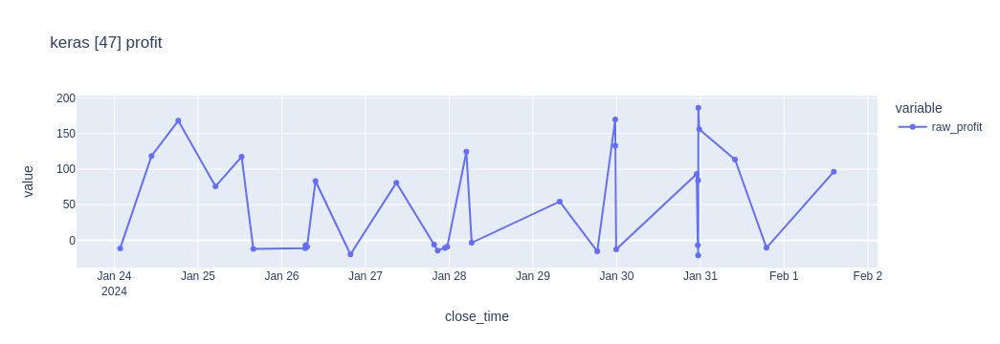

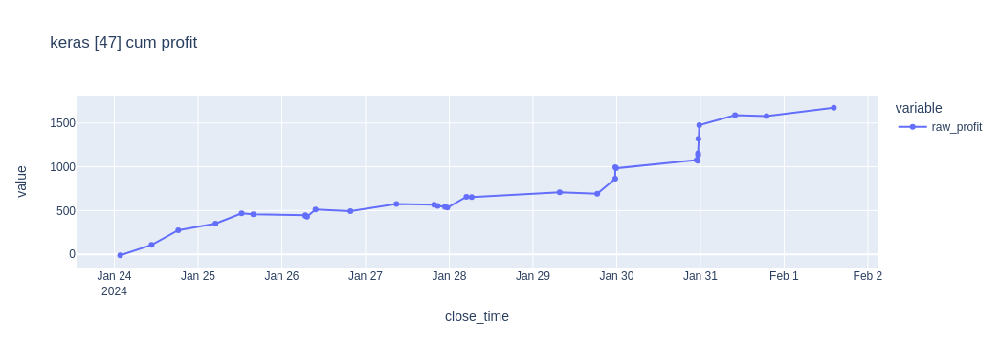

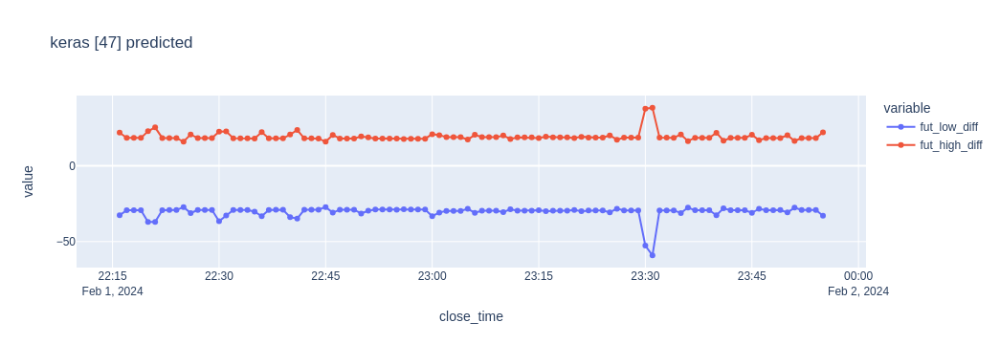

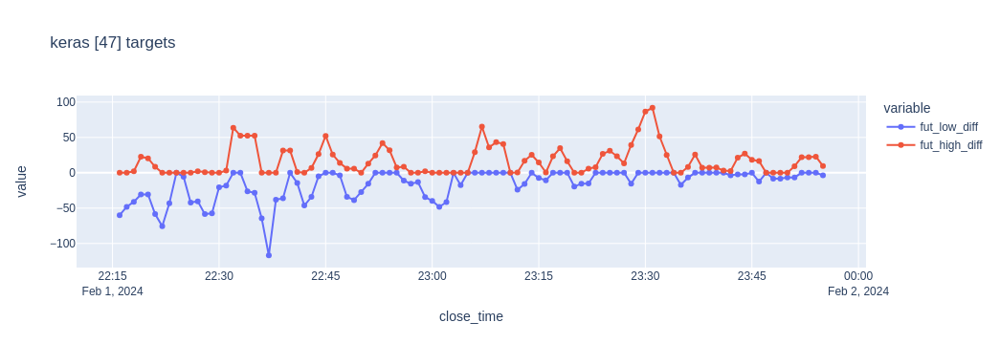

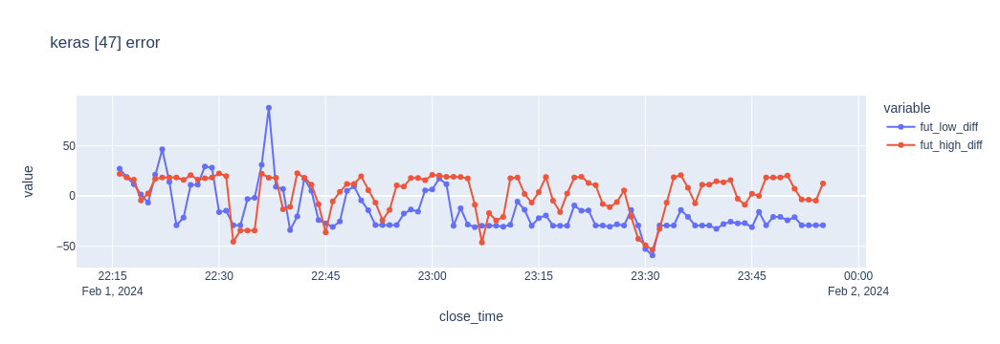

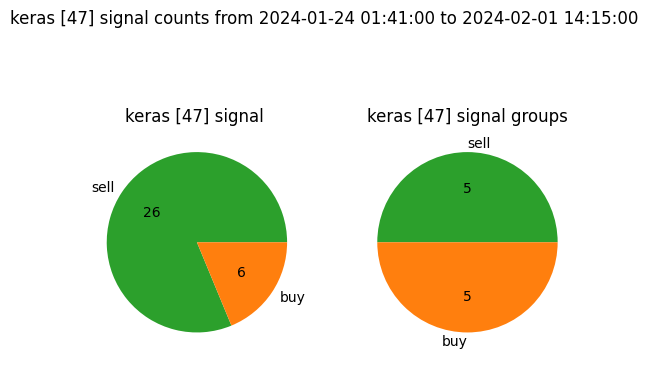

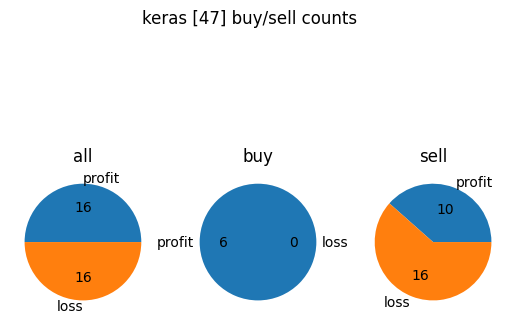

Calculating profit of model keras [47, 188, 16]
446/446 [==============================] - 0s 671us/step
Mean profit: nan
Mean buy: nan
Mean sell: nan
Median profit: nan
Median buy: nan
Median sell: nan


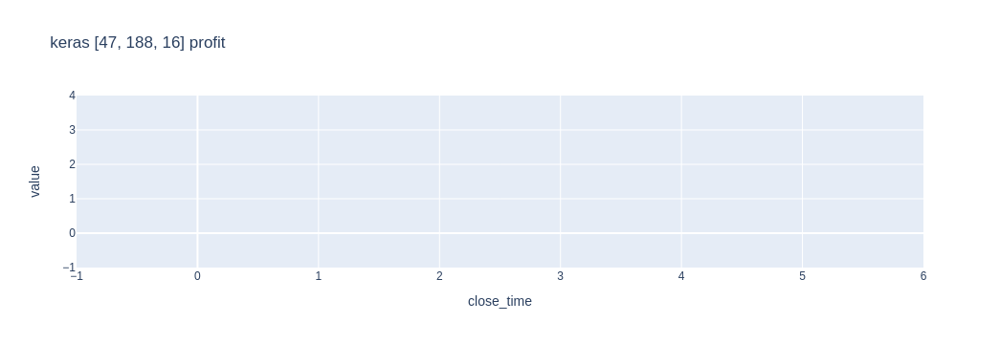

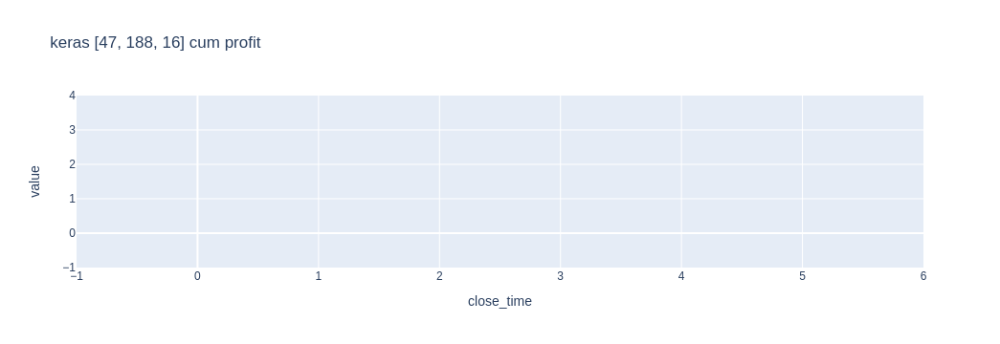

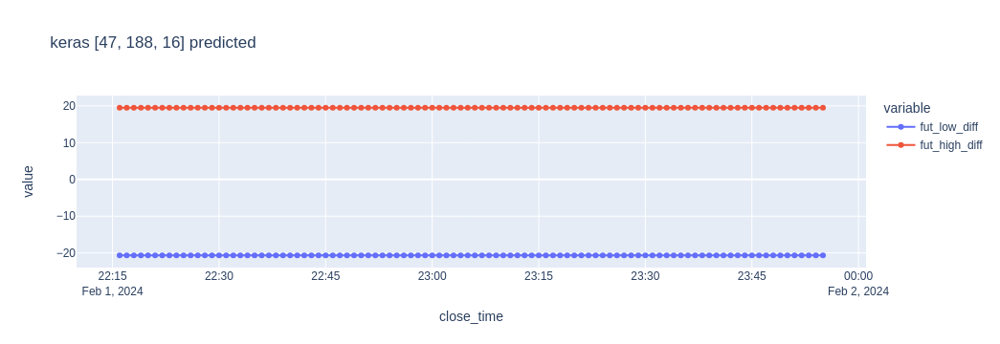

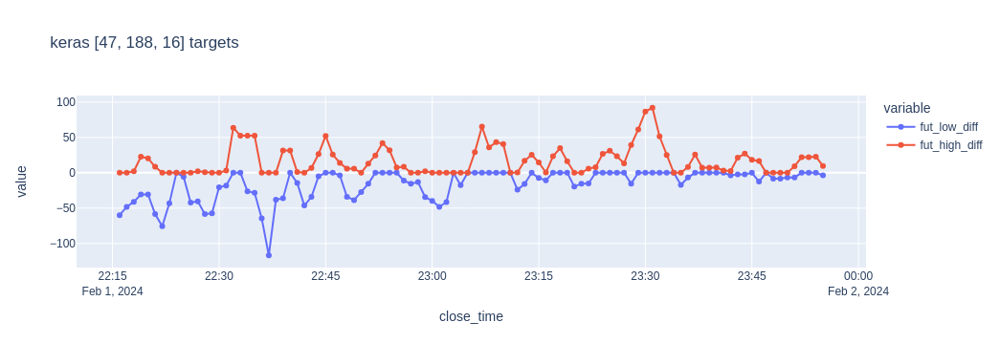

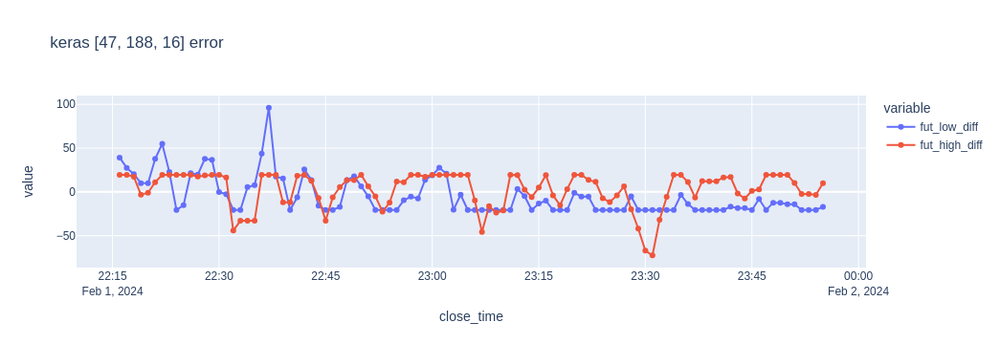

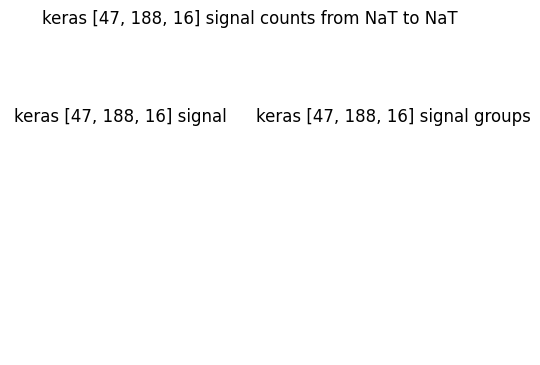

/home/dima/.local/share/virtualenvs/pytrade2-aH5jf7J6/lib/python3.11/site-packages/matplotlib/axes/_axes.py:3229: RuntimeWarning:

invalid value encountered in divide



ValueError: cannot convert float NaN to integer

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


ValueError: need at least one array to concatenate

<Figure size 640x480 with 3 Axes>

In [15]:
import matplotlib.pyplot as plt
import plotly.express as px
def calc_profit(y_pred, fut_lohi, candles):

    ii = y_pred.index.intersection(fut_lohi.index)
    y_pred = y_pred[y_pred.index.isin(ii)]

    y_pred['fut_low'] = candles['low'] + y_pred['fut_low_diff']
    y_pred['fut_high'] = candles['high'] + y_pred['fut_high_diff']
    
    fut_lohi = fut_lohi[fut_lohi.index.isin(ii)]

    # Calc signal from predicted low/high
    y_signal = calc_signal(candles, y_pred)
    y_signal = y_signal[y_signal['signal']!=0].dropna()

    # Set profit/loss for 1 and -1, because 0 is excluded before
    profit = (y_signal['tp']-candles['close']).abs()
    loss = (y_signal['sl']-candles['close']).abs()
    
    is_buy_profit = ((y_signal['signal']==1) 
                     & (y_pred['fut_low'] <= fut_lohi['fut_low']) 
                     & (y_pred['fut_high'] <= fut_lohi['fut_high']))
    is_buy_loss = (y_signal['signal']==1) & (~is_buy_profit)

    is_sell_profit = ((y_signal['signal']==-1) 
                     & (y_pred['fut_high'] >= fut_lohi['fut_high']) 
                     & (y_pred['fut_low'] >= fut_lohi['fut_low']))
    is_sell_loss = (y_signal['signal']==-1) & (~is_sell_profit)

    # Calc profit
    profit_df = y_signal[['signal']].copy()
    profit_df.loc[is_buy_profit | is_sell_profit,['raw_profit']] = profit
    profit_df.loc[is_buy_loss | is_sell_loss, 'raw_profit'] = -loss
    
    return y_pred[['fut_low_diff', 'fut_high_diff']], profit_df


def plot_buy_sell(name, profit_df):
    profit_cnt = len(profit_df[profit_df['raw_profit'] >= 0])
    loss_cnt = len(profit_df[profit_df['raw_profit'] < 0])
    buy_profit_cnt = len(profit_df[(profit_df['signal']== 1) & (profit_df['raw_profit'] >= 0)])
    buy_loss_cnt = len(profit_df[(profit_df['signal']== 1) & (profit_df['raw_profit'] < 0)])
    sell_profit_cnt = len(profit_df[(profit_df['signal']== -1) & (profit_df['raw_profit'] >= 0)])
    sell_loss_cnt = len(profit_df[(profit_df['signal']== -1) & (profit_df['raw_profit'] < 0)])

    all_data = {'profit': profit_cnt, 'loss': loss_cnt}
    buy_data = {'profit': buy_profit_cnt, 'loss': buy_loss_cnt}
    sell_data = {'profit': sell_profit_cnt, 'loss': sell_loss_cnt}

    fig, (ax_all, ax_buy, ax_sell) = plt.subplots(1,3)
    ax_all.pie([profit_cnt, loss_cnt], labels=['profit','loss'], autopct= lambda x: '{:.0f}'.format(x/100*(profit_cnt+loss_cnt)))
    ax_all.set_title(f'all')
    ax_buy.pie([buy_profit_cnt, buy_loss_cnt], labels=['profit','loss'], autopct= lambda x: '{:.0f}'.format(x/100*(buy_profit_cnt+buy_loss_cnt)))
    ax_buy.set_title('buy')
    ax_sell.pie([sell_profit_cnt, sell_loss_cnt], labels=['profit','loss'], autopct= lambda x: '{:.0f}'.format(x/100*(sell_profit_cnt+sell_loss_cnt)))
    ax_sell.set_title('sell')
    fig.suptitle(f'{name} buy/sell counts')
    plt.show()
    
def plot_profits(name, profit_df, y_pred, n_show=100):

        # Profit plot

        px.line(profit_df['raw_profit'], title=f'{name} profit').update_traces(mode='lines+markers').show()
        px.line(profit_df['raw_profit'].cumsum(), title=f'{name} cum profit').update_traces(mode='lines+markers').show()

        # Predicted and target value
        px.line(y_pred.tail(n_show), title=f'{name} predicted').update_traces(mode='lines+markers').show()
        px.line(y.tail(n_show), title=f'{name} targets').update_traces(mode='lines+markers').show()
        px.line((y_pred-y_test_df).tail(n_show),title=f'{name} error').update_traces(mode='lines+markers').show()

        # Signals counts piecharts
        plot_signal_counts(profit_df, name)    
    
        plot_buy_sell(name, profit_df)
        plt.show() 

def print_avg_profit(profit_df):
        print('Mean profit: ' + str(profit_df['raw_profit'].mean()))
        print('Mean buy: ' + str(profit_df[profit_df['signal']==1]['raw_profit'].mean()))
        print('Mean sell: ' + str(profit_df[profit_df['signal']==-1]['raw_profit'].mean()))

        print('Median profit: ' + str(profit_df['raw_profit'].median()))
        print('Median buy: ' + str(profit_df[profit_df['signal']==1]['raw_profit'].median()))
        print('Median sell: ' + str(profit_df[profit_df['signal']==-1]['raw_profit'].median()))

def eval_models_profits(models):
    for name, model in models.items():
        print(f'Calculating profit of model {name}')
        # Predict
        y_pred_raw = model.predict(x_test)
        y_pred = y_pipe.inverse_transform(y_pred_raw)
        y_pred = pd.DataFrame(data=y_pred, columns=['fut_low_diff', 'fut_high_diff'], index = x_test_df.index)        

        # Calculate profit
        y_pred, profit_df = calc_profit(y_pred, fut_lohi, candles)
        print_avg_profit(profit_df)
        plot_profits(name, profit_df, y_pred)

# Check case with 100% correct prediction
# y_pred_simulate = fut_lohi.copy()
# y_pred_simulate['fut_low_diff'] = y_pred_simulate['fut_low'] - candles.loc[y_pred_simulate.index, 'low']
# y_pred_simulate['fut_high_diff'] = y_pred_simulate['fut_high'] - candles.loc[y_pred_simulate.index, 'high']
# y_pred, profit_df = calc_profit( y_pred_simulate, fut_lohi, candles)
# plot_profits('fut_lohi', profit_df, y_pred)
if is_lgb:
    eval_models_profits(lgb_models)
if is_keras:
    eval_models_profits(keras_models)